In [1]:
import numpy as np  # useful for many scientific computing in Python

import pandas as pd # primary data structure library
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

!pip install geopandas
import geopandas as gpd
import requests # library to handle requests

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt


import json # library to handle JSON files

!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values



#!conda install -c conda-forge folium=0.5.0 --yes
import folium
from folium.plugins import HeatMap
import shapely
import seaborn as sns
from shapely.wkb import loads
#from shapely import wkt
from shapely.geometry import Point

# import k-means from clustering stage
from sklearn.cluster import KMeans


print('Imported Libraries')



Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.5.11
  latest version: 4.7.12

Please update conda by running

    $ conda update -n base -c defaults conda



# All requested packages already installed.

Imported Libraries


# Introduction

In this presentation we will define a problem to solve using Data Science techniques managing and processing data from different sources, including data pulled using an API, in this case, from Foursquare.com

The problem selected for this example is to determine best places to open a Coffee Shop in the city of Buenos Aires in the proximity of subway stations. 

There are a high number of variables to consider in such decision, but for the example of this practice, we will base our analysis in the data sets described below, leaving other important data, measurable or not, outside of the scope of the example.

The target user for this case is an interested partner in reviewing locations information and evaluate advantages of candidate location to setup a new Coffee Shop


# Problem Description

The problem selected is based in the city of Buenos Aires, in particular near the subway stations that concentrates a high number of people traveling daily across the city. 
Considering Coffee Shops are particularly popular in Argentina as meeting points for joining with friends, coworkers, and also for business, we will analyze different sets of data to determine best possible new place to open a new Coffee Shop. 



# Data Section

The data sets used along this study are:

From the Government of the city of Buenos Aires, official information:

1. Neighborhood information, with geographical location
1. Population for each Neighborhood from same source, but based on 2010 official data
1. Subway stations information, including geographical location and line
1. Premetro stations information (additional stations complimenting the subway network)
1. Traffic information of the subway stations

From Foursquare.com

1. Exploration of all Venues near subways stations
1. Exploration of specific categories of Coffee Shops near subway stations


### Buenos Aires city Neigborhood information with location data

In [2]:
borough=pd.read_csv('http://cdn.buenosaires.gob.ar/datosabiertos/datasets/barrios/barrios.csv')
borough.head()

,WKT,barrio,comuna,perimetro,area
0,"POLYGON ((-58.4528200492791 -34.5959886570639,...",CHACARITA,15,7724.852955,3.115707e+06
1,"POLYGON ((-58.4655768128541 -34.5965577078058,...",PATERNAL,15,7087.513295,2.229829e+06
2,"POLYGON ((-58.4237529813037 -34.5978273383243,...",VILLA CRESPO,15,8131.857075,3.615978e+06
3,"POLYGON ((-58.4946097568899 -34.6148652395239,...",VILLA DEL PARQUE,11,7705.389797,3.399596e+06
4,"POLYGON ((-58.4128700313089 -34.6141162515854,...",ALMAGRO,5,8537.901368,4.050752e+06


In [3]:
borough=borough.rename(columns={'barrio':'Borough'}).sort_values(by=['Borough']).reset_index(drop=True) #rename column and sort
borough.head()

,WKT,Borough,comuna,perimetro,area
0,"POLYGON ((-58.4771156675186 -34.5951149914833,...",AGRONOMIA,15,6556.167772,2.122169e+06
1,"POLYGON ((-58.4128700313089 -34.6141162515854,...",ALMAGRO,5,8537.901368,4.050752e+06
2,"POLYGON ((-58.4119188098038 -34.5980030767748,...",BALVANERA,3,8375.821811,4.342280e+06
3,"POLYGON ((-58.3703353711449 -34.6329258371189,...",BARRACAS,4,12789.791771,7.953453e+06
4,"POLYGON ((-58.4505669109009 -34.5356104340406,...",BELGRANO,13,20609.775397,7.999240e+06


### Buenos Aires Population by Borough Dataset

In [4]:
population=pd.read_csv('http://cdn.buenosaires.gob.ar/datosabiertos/datasets/barrios/caba_pob_barrios_2010.csv')
population=population.rename(columns={'BARRIO':'Borough', 'POBLACION':'Population'}) #rename column
population.head()

,Borough,Population
0,AGRONOMIA,13912
1,ALMAGRO,131699
2,BALVANERA,138926
3,BARRACAS,89452
4,BELGRANO,126267


In [5]:
#Join both Borough datasets together
borough=borough.join(population.set_index('Borough'), on='Borough')
print(borough.shape)
borough.head()

(48, 6)


,WKT,Borough,comuna,perimetro,area,Population
0,"POLYGON ((-58.4771156675186 -34.5951149914833,...",AGRONOMIA,15,6556.167772,2.122169e+06,13912
1,"POLYGON ((-58.4128700313089 -34.6141162515854,...",ALMAGRO,5,8537.901368,4.050752e+06,131699
2,"POLYGON ((-58.4119188098038 -34.5980030767748,...",BALVANERA,3,8375.821811,4.342280e+06,138926
3,"POLYGON ((-58.3703353711449 -34.6329258371189,...",BARRACAS,4,12789.791771,7.953453e+06,89452
4,"POLYGON ((-58.4505669109009 -34.5356104340406,...",BELGRANO,13,20609.775397,7.999240e+06,126267


Staritn reviewing Buenos Aires neighborhood data to check correlations

In [6]:
borough[['area','perimetro','Population']].corr()

,area,perimetro,Population
area,1.000000,0.792296,0.772145
perimetro,0.792296,1.000000,0.611126
Population,0.772145,0.611126,1.000000


/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(0, 286721.6210487207)

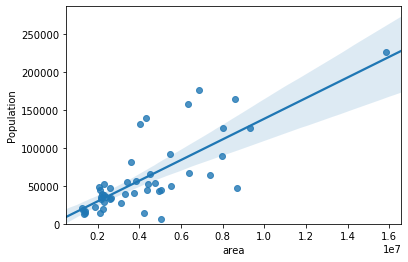

In [7]:
sns.regplot(x='area',y='Population', data=borough)
plt.ylim(0,)

The best correlation found is between each Borough area and its population

### Subway Information dataset

In [8]:
#Read subway stations names with geo locations
sub=pd.read_csv('http://cdn.buenosaires.gob.ar/datosabiertos/datasets/subte-estaciones/estaciones-de-subte.csv')
print(sub.shape)
sub.head()

(90, 5)


,long,lat,id,estacion,linea
0,-58.398928,-34.635750,1.0,CASEROS,H
1,-58.400970,-34.629376,2.0,INCLAN - MEZQUITA AL AHMAD,H
2,-58.402323,-34.623092,3.0,HUMBERTO 1°,H
3,-58.404732,-34.615242,4.0,VENEZUELA,H
4,-58.406036,-34.608935,5.0,ONCE - 30 DE DICIEMBRE,H


In [9]:
sub=sub.rename(columns={'estacion':'Station Name', 'linea':'Station Line'}) #rename column
sub=sub.drop(['id'],axis=1)
print(sub.shape)
sub=sub.sort_values(['Station Name','Station Line']).reset_index(drop=True)
sub.head()

(90, 4)


,long,lat,Station Name,Station Line
0,-58.380574,-34.604245,9 DE JULIO,D
1,-58.436429,-34.618280,ACOYTE,A
2,-58.407161,-34.591628,AGÜERO,D
3,-58.401208,-34.609834,ALBERTI,A
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B


Using geospatial data, determine neighborhood for each station and add it to sub dataframe

In [10]:
sub['Borough']='NaN'

In [11]:
#Add borough to each Station
for i in range(len(sub)):
    point=Point(sub.iloc[i,0],sub.iloc[i,1])
    for b in range(len(borough)):
        poly = shapely.wkt.loads(borough.iloc[b,0])
        if (poly.contains(point)):
            sub.iloc[i,4]=borough.iloc[b,1]
sub.head(10)

,long,lat,Station Name,Station Line,Borough
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO
5,-58.431274,-34.602162,ANGEL GALLARDO,B,ALMAGRO
6,-58.380611,-34.608983,AV. DE MAYO,C,MONSERRAT
7,-58.426789,-34.627015,AV. LA PLATA,E,PARQUE CHACABUCO
8,-58.377581,-34.612849,BELGRANO,E,MONSERRAT
9,-58.415533,-34.625366,BOEDO,E,BOEDO


### Premetro Data set
#### (This data was finally not used since lacks of traffic information and relatively has no venues)
Additional metro stations

In [12]:
#Read the external extension to the subway lines called "Premetro"
sub_pre=pd.read_csv('http://cdn.buenosaires.gob.ar/datosabiertos/datasets/premetro/estaciones-premetro.csv')
sub_pre=sub_pre.drop(['id'],axis=1)
sub_pre=sub_pre.rename(columns={'nombre':'Station Name', 'linea':'Station Line'}) #rename column
print(sub_pre.shape)
sub_pre.head()

(18, 4)


,long,lat,Station Line,Station Name
0,-58.461491,-34.643757,PREMETRO,INTENDENTE SAGUIER
1,-58.456415,-34.648601,PREMETRO,BALBASTRO (Cementerio de Flores)
2,-58.450047,-34.659499,PREMETRO,ANA MARÍA JANER
3,-58.446607,-34.662225,PREMETRO,FERNANDEZ DE LA CRUZ
4,-58.448513,-34.665368,PREMETRO,PTE. ILLIA (Lacarra)


In [13]:
#Join subway and premetro information
#sub= pd.concat([sub,sub_pre], sort=False).sort_values('Station Name').reset_index(drop=True)
print(sub.shape)
sub.head()

(90, 5)


,long,lat,Station Name,Station Line,Borough
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO


### Stations Traffic information
YTD 2019 from http://cdn.buenosaires.gob.ar/datosabiertos/datasets/subte-viajes-molinetes/molinetes-2019.zip

In [14]:
#Read uncompressed dataset already loaded containing first 8 months of 2019 people traffic
sub_u=pd.read_csv(r'datahistorica082019.csv')
sub_u.head()

,periodo,fecha,desde,hasta,linea,molinete,estacion,pax_pagos,pax_pases_pagos,pax_franq,total
0,201901,2019-01-01,08:00:00,08:15:00,LineaA,LineaA_Lima_N_Turn02,Lima,1.0,0.0,0.0,1.0
1,201901,2019-01-01,08:00:00,08:15:00,LineaA,LineaA_Loria_N_Turn03,Loria,3.0,0.0,0.0,3.0
2,201901,2019-01-01,08:00:00,08:15:00,LineaA,LineaA_Miserere_Q_HALL_Turn01,Plaza Miserere,3.0,0.0,0.0,3.0
3,201901,2019-01-01,08:00:00,08:15:00,LineaA,LineaA_Miserere_S_Turn01,Plaza Miserere,6.0,0.0,0.0,6.0
4,201901,2019-01-01,08:00:00,08:15:00,LineaA,LineaA_Miserere_S_Turn03,Plaza Miserere,10.0,0.0,0.0,10.0


In [15]:
#Discard not needed columns
sub_use=sub_u.drop(['desde','hasta','pax_pagos','pax_pases_pagos','pax_franq'],1)
print('Subway 2019 passengers records dataset: ',sub_use.shape)
start=sub_use.iloc[0,1]
end=sub_use.iloc[-1,1]
print('Subway passengers initial date: ',start,' final date measured: ',end)
sub_use.tail()

Subway 2019 passengers records dataset:  (8300108, 6)
Subway passengers initial date:  2019-01-01  final date measured:  2019-08-31


,periodo,fecha,linea,molinete,estacion,total
8300103,201908,2019-08-31,LineaD,LineaD_9Julio_S_Turn02,9 de julio,4.0
8300104,201908,2019-08-31,LineaD,LineaD_Pueyrredon_Turn01,Pueyrredon.D,1.0
8300105,201908,2019-08-31,LineaH,LineaH_Once_Norte_Turn04,Once,1.0
8300106,201908,2019-08-31,LineaH,LineaH_Once_Sur_Turn02,Once,1.0
8300107,201908,2019-08-31,LineaH,LineaH_Venezuela_Sur_Turn01,Venezuela,2.0


In [16]:
sub_use=sub_use.groupby(['estacion','linea']).sum()['total'].to_frame().reset_index().sort_values(['estacion','linea']).reset_index(drop=True)
sub_use['linea'] = sub_use['linea'].str.replace('Linea','')
sub_use=sub_use.rename(columns={'estacion':'Station', 'linea':'Line'}) #rename column
sub_use['Station']=sub_use['Station'].str.upper() 
sub_use.head()

,Station,Line,total
0,9 DE JULIO,D,1832363.0
1,ACOYTE,A,2891038.0
2,AGÃÂ¼ERO,D,450586.0
3,AGÃ¼ERO,D,1160895.0
4,AGÜERO,D,630504.0


In [17]:
sub_use=sub_use.rename(columns={'Station':'Station Name', 'Line':'Station Line'}) #rename column

Need to correct stations names in dataset cotaining traffic information to match stations 

In [18]:
# Correct station names and convert to uppercase
sub_use.at[2,'Station Name']='AGÜERO'
sub_use.at[3,'Station Name']='AGÜERO'
sub_use.at[4,'Station Name']='AGÜERO'
sub_use.at[7,'Station Name']=sub.at[7,'Station Name']
sub_use.at[8,'Station Name']=sub.at[6,'Station Name']
sub_use.at[13,'Station Name']='CALLAO - MAESTRO ALFREDO BRAVO'
sub_use.at[16,'Station Name']=sub.at[12,'Station Name']
sub_use.at[21,'Station Name']=sub.at[21,'Station Name']
sub_use.at[24,'Station Name']=sub.at[26,'Station Name']
sub_use.at[37,'Station Name']='BELGRANO'
sub_use.at[40,'Station Name']='HUMBERTO 1°'
sub_use.at[41,'Station Name']='INCLAN - MEZQUITA AL AHMAD'
sub_use.at[53,'Station Name']=sub.at[27,'Station Name']
sub_use.at[54,'Station Name']='MALABIA - OSVALDO PUGLIESE'
sub_use.at[55,'Station Name']=sub.at[55,'Station Name']
sub_use.at[57,'Station Name']='ALMAGRO - MEDRANO'
sub_use.at[60,'Station Name']='ONCE - 30 DE DICIEMBRE'
sub_use.at[64,'Station Name']='PARQUE PATRICIOS'
sub_use.at[69,'Station Name']=sub.at[67,'Station Name']#mise
sub_use.at[74,'Station Name']=sub.at[72,'Station Name']#puey
sub_use.at[75,'Station Name']=sub.at[65,'Station Name']
sub_use.at[79,'Station Name']='JUAN MANUEL DE ROSAS - VILLA URQUIZA'
sub_use.at[80,'Station Name']=sub.at[77,'Station Name']
sub_use.at[81,'Station Name']=sub.at[77,'Station Name']
sub_use.at[82,'Station Name']=sub.at[77,'Station Name']
sub_use.at[86,'Station Name']=sub.at[83,'Station Name']
sub_use.at[87,'Station Name']='R.SCALABRINI ORTIZ'
sub_use.at[89,'Station Name']='TRONADOR - VILLA ORTÚZAR'
sub_use.at[88,'Station Name']='TRIBUNALES - TEATRO COLÓN'
sub_use.at[58,'Station Name']='MINISTRO CARRANZA - MIGUEL ABUELO'
sub_use.at[53,'Station Name']=sub.at[27,'Station Name']
sub_use.at[29,'Station Name']=sub.at[30,'Station Name']
sub_use.at[31,'Station Name']=sub.at[32,'Station Name']
sub_use.at[32,'Station Name']=sub.at[33,'Station Name']
sub_use.at[35,'Station Name']=sub.at[79,'Station Name']
sub_use.at[43,'Station Name']=sub.at[41,'Station Name']
sub_use.at[63,'Station Name']=sub.at[61,'Station Name']
sub_use.at[45,'Station Name']=sub.at[43,'Station Name']
sub_use.at[77,'Station Name']=sub.at[75,'Station Name']
sub_use.at[38,'Station Name']=sub.at[81,'Station Name']


#Regroup to recalculate totals
sub_use=sub_use.groupby(['Station Name','Station Line']).sum()['total'].to_frame().reset_index().sort_values(['Station Name']).reset_index(drop=True)
sub_use.head(10)

,Station Name,Station Line,total
0,9 DE JULIO,D,1832363.0
1,ACOYTE,A,2891038.0
2,AGÜERO,D,2241985.0
3,ALBERTI,A,958847.0
4,ALMAGRO - MEDRANO,B,3409340.0
5,ANGEL GALLARDO,B,3048723.0
6,AV. DE MAYO,C,1104846.0
7,AV. LA PLATA,E,984719.0
8,BELGRANO,E,574222.0
9,BOEDO,E,875852.0


In [19]:
sub=sub.join(sub_use.set_index(['Station Name','Station Line']), on=['Station Name','Station Line'])      
sub.head()

,long,lat,Station Name,Station Line,Borough,total
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,1832363.0
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO,2891038.0
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA,2241985.0
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA,958847.0
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO,3409340.0


In [20]:
#Convert total in traffic per month
sub['total']=sub['total']/8
sub['total']=sub["total"].astype(int)
sub.head()

,long,lat,Station Name,Station Line,Borough,total
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO,361379
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA,280248
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA,119855
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO,426167


In [21]:
#Normalize total traffic adding column
sub['totalN'] =  'NaN'
sub['totalN']=sub['total']/sub['total'].max()
sub.head()

,long,lat,Station Name,Station Line,Borough,total,totalN
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO,361379,0.173803
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA,280248,0.134783
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA,119855,0.057643
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO,426167,0.204962


In [22]:
sub.sort_values(['total'],ascending=False).head(10)

,long,lat,Station Name,Station Line,Borough,total,totalN
23,-58.381434,-34.627619,CONSTITUCION,C,CONSTITUCION,2079250,1.000000
22,-58.462378,-34.555642,CONGRESO DE TUCUMAN,D,BELGRANO,910717,0.438003
74,-58.374018,-34.591194,RETIRO,C,RETIRO,892739,0.429356
35,-58.455029,-34.587198,FEDERICO LACROZE,B,CHACARITA,806231,0.387751
20,-58.373956,-34.607802,CATEDRAL,D,SAN NICOLAS,754907,0.363067
82,-58.469640,-34.630707,SAN PEDRITO,A,FLORES,709365,0.341164
44,-58.486385,-34.574319,JUAN MANUEL DE ROSAS - VILLA URQUIZA,B,VILLA URQUIZA,706195,0.339639
49,-58.369930,-34.602989,LEANDRO N. ALEM,B,SAN NICOLAS,637671,0.306683
12,-58.380715,-34.603637,C. PELLEGRINI,B,SAN NICOLAS,550765,0.264886
36,-58.375072,-34.603297,FLORIDA,B,SAN NICOLAS,500586,0.240753


In [23]:
line=sub.groupby(['Station Line']).sum()['total'].to_frame()
line=line.sort_values('total', ascending=False).reset_index()
line

,Station Line,total
0,B,7163409
1,D,6585277
2,A,5125360
3,C,4154875
4,H,2777585
5,E,1832732


After counting stations total found total monthly traffic per subway line to be used later as a variable to determine the business decission of the problem

___________

## Visualtization of Boroughs with Populations and Subway stations

In [24]:
url = 'http://cdn.buenosaires.gob.ar/datosabiertos/datasets/barrios'
bsas_geo= f'{url}/barrios.geojson'

In [25]:
map_bsas=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)

In [26]:
# MAP Buenos Aires
map_bsas=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)
map_bsas.choropleth(
    geo_data=bsas_geo,
    data=borough,
    columns=['Borough','Population'],
    key_on='feature.properties.barrio',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Population in Buenos Aires city  &  Subway Station Traffic'
)
#add Stations to the Map
markers_colors = []
for lat, lon, station, line in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        popup=label,
        color='black',
        fill=True,
        fill_opacity=0.7).add_to(map_bsas) 
map_bsas

In [27]:
#Adding monthly people tranist data per Station
for lat, lon, station, line,totalN in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line'],sub['totalN']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=totalN*40,
        popup=label,
        color='green',
        fill=True,
        fill_opacity=0.3).add_to(map_bsas) 
map_bsas

---------
--------

### Foursquare Venues Explore

In [28]:
CLIENT_ID = 'JK4SBLGN3YU1DKHQS40VSJ2RUTBDQ0BF0VE2X2J0E2HSDR3M' # your Foursquare ID
CLIENT_SECRET = 'QXOOOJBSDA10TTVT50BRHURLN2NEBGMZEKAWC3XPHPS4XD2M' # your Foursquare Secret
VERSION = '20190605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: JK4SBLGN3YU1DKHQS40VSJ2RUTBDQ0BF0VE2X2J0E2HSDR3M
CLIENT_SECRET:QXOOOJBSDA10TTVT50BRHURLN2NEBGMZEKAWC3XPHPS4XD2M


In [ ]:
def getNearbyVenues(names, line, latitudes, longitudes, radius=800):
    LIMIT = 200 # limit of number of venues returned by Foursquare API
    radius = 800 # define radius
    venues_list=[]
    for name, line, lat, lng in zip(names, line, latitudes, longitudes):
         # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius,
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            line,
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['location']['distance'],
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Station Line',
                  'Station Name',
                  'Station Latitude', 
                  'Station Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Distance',
                  'Venue Category']
    return(nearby_venues)


#Create dataframe with Venues of Buenos Aires
bsas_venues = getNearbyVenues(names=sub['Station Name'],
                                   line=sub['Station Line'],
                                   latitudes=sub['lat'],
                                   longitudes=sub['long'])

#To execute only once and avoid Foursquare limite save to disk
bsas_venues.to_csv (r'venues_subs.csv', index = None, header=True) 

In [29]:
#Readl from disk
bsas_venues=pd.read_csv(r'venues_subs.csv')
print('There are a total of',bsas_venues.shape[0],'"venues" returned by Foursquare near subway stations')
bsas_venues.head()

There are a total of 7070 "venues" returned by Foursquare near subway stations


,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,D,9 DE JULIO,-34.604245,-58.380574,Obelisco - Plaza de la República,-34.603736,-58.381632,112,Monument / Landmark
1,D,9 DE JULIO,-34.604245,-58.380574,Teatro Gran Rex,-34.603237,-58.378928,188,Theater
2,D,9 DE JULIO,-34.604245,-58.380574,On Fit,-34.602386,-58.379985,213,Gym / Fitness Center
3,D,9 DE JULIO,-34.604245,-58.380574,All Saints Cafe,-34.603559,-58.378070,241,Coffee Shop
4,D,9 DE JULIO,-34.604245,-58.380574,Tostado Café Club,-34.603494,-58.380793,85,Coffee Shop


#### Find and remove duplicated Venues

In [30]:
bsas_venues=bsas_venues.sort_values(by=['Venue','Venue Latitude','Venue Longitude','Venue Distance']).reset_index(drop=True)
bsas_venues.head(20)

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,A,CONGRESO - PDTE. DR. RAÚL R. ALFONSÍN,-34.609226,-58.392669,1745,-34.607881,-58.391271,197,Bar
1,B,CALLAO - MAESTRO ALFREDO BRAVO,-34.604420,-58.392314,1745,-34.607881,-58.391271,397,Bar
2,A,SAENZ PEÑA,-34.609413,-58.386777,1745,-34.607881,-58.391271,445,Bar
3,B,URUGUAY,-34.604094,-58.387296,1745,-34.607881,-58.391271,557,Bar
4,A,PASCO,-34.609646,-58.398427,1745,-34.607881,-58.391271,684,Bar
5,C,AV. DE MAYO,-34.608983,-58.380611,180 Burger Bar,-34.604848,-58.380574,460,Burger Joint
6,A,PIEDRAS,-34.608882,-58.379085,180 Burger Bar,-34.604848,-58.380574,469,Burger Joint
7,A,LIMA,-34.609100,-58.382232,180 Burger Bar,-34.604848,-58.380574,497,Burger Joint
8,B,URUGUAY,-34.604094,-58.387296,180 Burger Bar,-34.604848,-58.380574,621,Burger Joint
9,D,R.SCALABRINI ORTIZ,-34.585156,-58.415955,1810,-34.589351,-58.419117,549,Argentinian Restaurant


In [31]:
#Remove duplicated keeping closest Venue to the Station
#bsas_venues=bsas_venues.drop_duplicates(subset=['Venue','Venue Latitude','Venue Longitude'], keep='first').reset_index(drop=True)
print('There are a total of',bsas_venues.shape[0],'"venues" ')
bsas_venues.head(10)

There are a total of 7070 "venues" 


,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,A,CONGRESO - PDTE. DR. RAÚL R. ALFONSÍN,-34.609226,-58.392669,1745,-34.607881,-58.391271,197,Bar
1,B,CALLAO - MAESTRO ALFREDO BRAVO,-34.604420,-58.392314,1745,-34.607881,-58.391271,397,Bar
2,A,SAENZ PEÑA,-34.609413,-58.386777,1745,-34.607881,-58.391271,445,Bar
3,B,URUGUAY,-34.604094,-58.387296,1745,-34.607881,-58.391271,557,Bar
4,A,PASCO,-34.609646,-58.398427,1745,-34.607881,-58.391271,684,Bar
5,C,AV. DE MAYO,-34.608983,-58.380611,180 Burger Bar,-34.604848,-58.380574,460,Burger Joint
6,A,PIEDRAS,-34.608882,-58.379085,180 Burger Bar,-34.604848,-58.380574,469,Burger Joint
7,A,LIMA,-34.609100,-58.382232,180 Burger Bar,-34.604848,-58.380574,497,Burger Joint
8,B,URUGUAY,-34.604094,-58.387296,180 Burger Bar,-34.604848,-58.380574,621,Burger Joint
9,D,R.SCALABRINI ORTIZ,-34.585156,-58.415955,1810,-34.589351,-58.419117,549,Argentinian Restaurant


### Add Borough to each Venue (optional)

In [32]:
bsas_venues['Borough'] =  'NaN'
bsas_venues.head()

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category,Borough
0,A,CONGRESO - PDTE. DR. RAÚL R. ALFONSÍN,-34.609226,-58.392669,1745,-34.607881,-58.391271,197,Bar,NaN
1,B,CALLAO - MAESTRO ALFREDO BRAVO,-34.604420,-58.392314,1745,-34.607881,-58.391271,397,Bar,NaN
2,A,SAENZ PEÑA,-34.609413,-58.386777,1745,-34.607881,-58.391271,445,Bar,NaN
3,B,URUGUAY,-34.604094,-58.387296,1745,-34.607881,-58.391271,557,Bar,NaN
4,A,PASCO,-34.609646,-58.398427,1745,-34.607881,-58.391271,684,Bar,NaN


#Optional for now
for i in range(len(bsas_venues)):
    #print('Latitude', bsas_venues.iloc[i,5])
    #print('Longitude', bsas_venues.iloc[i,6])
    point=Point(bsas_venues.iloc[i,6],bsas_venues.iloc[i,5])
    for b in range(len(borough)):
        poly = shapely.wkt.loads(borough.iloc[b,0])
        if (poly.contains(point)):
            bsas_venues.iloc[i,9]=borough.iloc[b,1]
bsas_venues.head()

In [33]:
print(bsas_venues.shape)

(7070, 10)


------------


## Analyze Venues

We have the "bsas_venues" data set containing 7084 "Venues" with location and near Station, together with the Borough information

To better interpret the data will aggregate venues founds across all Stations by Venue Category

In [34]:
bsas_cat=bsas_venues.groupby(['Venue Category']).count().sort_values('Venue',ascending=False)
bsas_cat.head()

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Borough
Venue Category,,,,,,,,,
Café,525,525,525,525,525,525,525,525,525
Coffee Shop,488,488,488,488,488,488,488,488,488
Argentinian Restaurant,447,447,447,447,447,447,447,447,447
Hotel,396,396,396,396,396,396,396,396,396
Pizza Place,351,351,351,351,351,351,351,351,351


In [35]:
print('There are {} uniques categories.'.format(len(bsas_venues['Venue Category'].unique())))

There are 245 uniques categories.


In most importants, realized "Cafe" and "Coffe shop" are the same, so set as unique category

In [36]:
bsas_venues["Venue Category"].replace("Coffee Shop","Café",inplace=True)
bsas_cat=bsas_venues.groupby(['Venue Category']).count().sort_values('Venue',ascending=False)
bsas_cat.head()

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Borough
Venue Category,,,,,,,,,
Café,1013,1013,1013,1013,1013,1013,1013,1013,1013
Argentinian Restaurant,447,447,447,447,447,447,447,447,447
Hotel,396,396,396,396,396,396,396,396,396
Pizza Place,351,351,351,351,351,351,351,351,351
Ice Cream Shop,309,309,309,309,309,309,309,309,309


(244, 9)


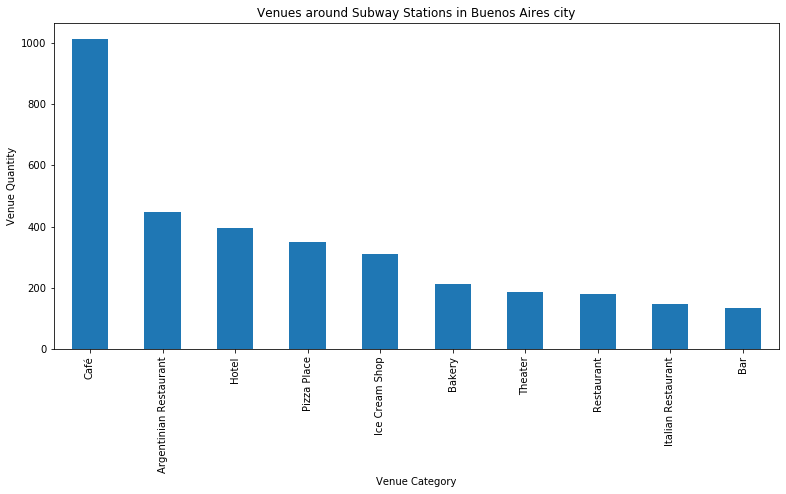

In [37]:
bsas_cat['Venue'].head(10).plot( kind='bar', figsize=(13, 6))

plt.xlabel('Venue Category') # add to x-label to the plot
plt.ylabel('Venue Quantity') # add y-label to the plot
plt.title('Venues around Subway Stations in Buenos Aires city') # add title to the plot
print(bsas_cat.shape)
plt.show()

This first representation clearly identifies the "Café" venue, as the most important

Will check aggregating by Station

In [38]:
#Check qty of Venues per Station
bsas_venues.groupby(['Station Name','Station Line']).count().sort_values('Venue', ascending=False).head()

,,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category,Borough
Station Name,Station Line,,,,,,,,
9 DE JULIO,D,100,100,100,100,100,100,100,100
CORREO CENTRAL,E,100,100,100,100,100,100,100,100
FACULTAD DE MEDICINA,D,100,100,100,100,100,100,100,100
FLORIDA,B,100,100,100,100,100,100,100,100
TRIBUNALES - TEATRO COLÓN,D,100,100,100,100,100,100,100,100


The previous table shows the venues per Station reached the limit of 100 from Foursquere.com so don't know the real numbers
Will try anywau to make some analysis

#### Analyze Stations

In [39]:
# one hot encoding
bsas_onehot = pd.get_dummies(bsas_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
bsas_onehot['Station Line'] = bsas_venues['Station Line']
bsas_onehot['Station Name'] = bsas_venues['Station Name']

# move Station columns to the firsts
fixed_columns = [bsas_onehot.columns[-1]]+[bsas_onehot.columns[-2]] + list(bsas_onehot.columns[:-2])
bsas_onehot = bsas_onehot[fixed_columns]
print(bsas_onehot.shape)
bsas_onehot.head()

(7070, 246)


,Station Name,Station Line,Adult Boutique,American Restaurant,Amphitheater,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Camera Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Clothing Store,Cocktail Bar,College Auditorium,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Shop,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Paella Restaurant,Paper / Office Supplies Store,Park,Parking,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Pizza Place,Playground,Plaza,Pool,Pool Hall,Print Shop,Pub,Public Art,Record Shop,Recording Studio,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Steakhouse,Street Fair,Street Food Gathering,Supermarket,Sushi Restaurant,Swiss Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Restaurant,Thrift / Vintage Store,Toll Booth,Toy / Game Store,Track,Train Station,Used Bookstore,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,CONGRESO - PDTE. DR. RAÚL R. ALFONSÍN,A,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

Gouping by Station and standarize by taking the mean of the frequency of occurrence of each category

In [40]:
bsas_grouped = bsas_onehot.groupby(['Station Name','Station Line']).mean().reset_index()
print (bsas_grouped.shape)
bsas_grouped=bsas_grouped.sort_values('Station Name')
print(sub.shape)
bsas_grouped.head()

(90, 246)
(90, 7)


,Station Name,Station Line,Adult Boutique,American Restaurant,Amphitheater,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Camera Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Clothing Store,Cocktail Bar,College Auditorium,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Shop,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Paella Restaurant,Paper / Office Supplies Store,Park,Parking,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Pizza Place,Playground,Plaza,Pool,Pool Hall,Print Shop,Pub,Public Art,Record Shop,Recording Studio,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Steakhouse,Street Fair,Street Food Gathering,Supermarket,Sushi Restaurant,Swiss Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Restaurant,Thrift / Vintage Store,Toll Booth,Toy / Game Store,Track,Train Station,Used Bookstore,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,9 DE JULIO,D,0.000000,0.00,0.0,0.0,0.0,0.030000,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.020000,0.0,0.010000,0.0,0.000000,0.00,0.0,0.01,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.030000,0.0,0.0,0.0,0.0,0.00,0.000000,0.020000,0.0,0.000000,0.0,0.0,0.220000,0.02,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.00,0.00,0.01,0.0,0.000000,0.0,0.00,0.00,0.010000,0.0,0.00,0.0,0.0,0.0,0.0,0.000000,0.010000,0.01,0.0,0.0,0.0,0.000000,0.010000,0.0,0.0,0.00,0.000000,0.00,0.0,0.000000,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0

#### Create dataframe with each Station along with the top 10 most common venues

In [41]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[2:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
  
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Station Name','Station Line']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
station_venues_sorted = pd.DataFrame(columns=columns)
station_venues_sorted['Station Name'] = bsas_grouped['Station Name']
station_venues_sorted['Station Line'] = bsas_grouped['Station Line']

for ind in np.arange(bsas_grouped.shape[0]):
    station_venues_sorted.iloc[ind, 2:] = return_most_common_venues(bsas_grouped.iloc[ind, :], num_top_venues)

station_venues_sorted=station_venues_sorted.sort_values('Station Name')
print(station_venues_sorted.shape)
station_venues_sorted.head()

(90, 12)


,Station Name,Station Line,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,9 DE JULIO,D,Café,Hotel,Theater,Pizza Place,Restaurant,Bookstore,Sandwich Place,Gym / Fitness Center,Argentinian Restaurant,Sushi Restaurant
1,ACOYTE,A,Café,Ice Cream Shop,Bakery,Pizza Place,Grocery Store,Pharmacy,Gym,Restaurant,Argentinian Restaurant,Playground
2,AGÜERO,D,Café,Bakery,Ice Cream Shop,Pizza Place,Argentinian Restaurant,Hotel,Gym,Salad Place,Empanada Restaurant,Clothing Store
3,ALBERTI,A,Café,Gym,Pizza Place,Hotel,Japanese Restaurant,Spanish Restaurant,Metro Station,Bar,Bakery,Grocery Store
4,ALMAGRO - MEDRANO,B,Café,Argentinian Restaurant,Pizza Place,Theater,Restaurant,Bar,Gym,Ice Cream Shop,Vegetarian / Vegan Restaurant,Performing Arts Venue


---------

## Clustering the Foursquere Venues

### Determining number of clusters based on Elbow curve method

In [42]:
print(bsas_grouped.shape)
bsas_grouped.head(10)

(90, 246)


,Station Name,Station Line,Adult Boutique,American Restaurant,Amphitheater,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Camera Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Clothing Store,Cocktail Bar,College Auditorium,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Shop,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Paella Restaurant,Paper / Office Supplies Store,Park,Parking,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Pizza Place,Playground,Plaza,Pool,Pool Hall,Print Shop,Pub,Public Art,Record Shop,Recording Studio,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Steakhouse,Street Fair,Street Food Gathering,Supermarket,Sushi Restaurant,Swiss Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Restaurant,Thrift / Vintage Store,Toll Booth,Toy / Game Store,Track,Train Station,Used Bookstore,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,9 DE JULIO,D,0.000000,0.00,0.000000,0.0,0.0,0.030000,0.000000,0.0,0.000000,0.0,0.00,0.000000,0.0,0.00,0.000000,0.020000,0.0,0.010000,0.0,0.000000,0.00,0.0,0.01,0.000000,0.0,0.0,0.000000,0.000000,0.00,0.0,0.030000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.020000,0.0,0.000000,0.0,0.000000,0.220000,0.02,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.01,0.0,0.000000,0.000000,0.00,0.01,0.0,0.000000,0.0,0.00,0.000000,0.010000,0.000000,0.00000,0.000000,0.0,0.0,0.0,0.000000,0.010000,0.01,0.0,0.0,0.0,0.000000,0.01

In [43]:
#Dataset to cluster
bsas_grouped_clustering = bsas_grouped.drop(['Station Name','Station Line'], 1)
bsas_grouped_clustering.head(10)
print(bsas_grouped_clustering.shape)
bsas_grouped_clustering.head(1)

(90, 244)


,Adult Boutique,American Restaurant,Amphitheater,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bistro,Board Shop,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Bus Station,Bus Stop,Butcher,Cafeteria,Café,Camera Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Circus,Clothing Store,Cocktail Bar,College Auditorium,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Shop,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Paella Restaurant,Paper / Office Supplies Store,Park,Parking,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Pizza Place,Playground,Plaza,Pool,Pool Hall,Print Shop,Pub,Public Art,Record Shop,Recording Studio,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Steakhouse,Street Fair,Street Food Gathering,Supermarket,Sushi Restaurant,Swiss Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Restaurant,Thrift / Vintage Store,Toll Booth,Toy / Game Store,Track,Train Station,Used Bookstore,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,0.0,0.0,0.0,0.0,0.0,0.03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.01,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.03,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.0,0.0,0.0,0.22,0.02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.01,0.01,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.0,0.0,0

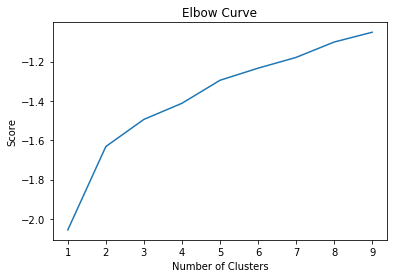

In [44]:
Nc = range(1, 10)
kmeans = [KMeans(n_clusters=i) for i in Nc]
kmeans
score = [kmeans[i].fit(bsas_grouped_clustering).score(bsas_grouped_clustering) for i in range(len(kmeans))]
score
plt.plot(Nc,score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

Based on Elbow Curve, we can select 2 or 5 Clusters
Selecting 6 can not figure out the criteria choosed, so selected 2

In [45]:
# set number of clusters
kclusters = 5

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(bsas_grouped_clustering)
kmeans

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([4, 2, 2, 4, 3, 3, 4, 3, 1, 3], dtype=int32)

In [46]:
print(kmeans.labels_)
station_venues_sorted.head()


[4 2 2 4 3 3 4 3 1 3 1 3 4 4 4 2 3 2 3 1 1 4 3 3 1 2 2 2 4 3 2 3 3 1 1 3 4
 3 3 3 1 1 2 3 2 3 2 1 4 1 4 3 3 3 3 1 2 2 3 3 4 4 1 3 4 0 1 2 3 2 2 2 1 1
 1 1 2 4 1 2 1 1 2 1 4 3 3 4 0 2]


,Station Name,Station Line,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,9 DE JULIO,D,Café,Hotel,Theater,Pizza Place,Restaurant,Bookstore,Sandwich Place,Gym / Fitness Center,Argentinian Restaurant,Sushi Restaurant
1,ACOYTE,A,Café,Ice Cream Shop,Bakery,Pizza Place,Grocery Store,Pharmacy,Gym,Restaurant,Argentinian Restaurant,Playground
2,AGÜERO,D,Café,Bakery,Ice Cream Shop,Pizza Place,Argentinian Restaurant,Hotel,Gym,Salad Place,Empanada Restaurant,Clothing Store
3,ALBERTI,A,Café,Gym,Pizza Place,Hotel,Japanese Restaurant,Spanish Restaurant,Metro Station,Bar,Bakery,Grocery Store
4,ALMAGRO - MEDRANO,B,Café,Argentinian Restaurant,Pizza Place,Theater,Restaurant,Bar,Gym,Ice Cream Shop,Vegetarian / Vegan Restaurant,Performing Arts Venue


In [47]:
# add clustering labels
station_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)
station_venues_sorted.head()


,Cluster Labels,Station Name,Station Line,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,4,9 DE JULIO,D,Café,Hotel,Theater,Pizza Place,Restaurant,Bookstore,Sandwich Place,Gym / Fitness Center,Argentinian Restaurant,Sushi Restaurant
1,2,ACOYTE,A,Café,Ice Cream Shop,Bakery,Pizza Place,Grocery Store,Pharmacy,Gym,Restaurant,Argentinian Restaurant,Playground
2,2,AGÜERO,D,Café,Bakery,Ice Cream Shop,Pizza Place,Argentinian Restaurant,Hotel,Gym,Salad Place,Empanada Restaurant,Clothing Store
3,4,ALBERTI,A,Café,Gym,Pizza Place,Hotel,Japanese Restaurant,Spanish Restaurant,Metro Station,Bar,Bakery,Grocery Store
4,3,ALMAGRO - MEDRANO,B,Café,Argentinian Restaurant,Pizza Place,Theater,Restaurant,Bar,Gym,Ice Cream Shop,Vegetarian / Vegan Restaurant,Performing Arts Venue


In [48]:
# merge station venues with subway data to add latitude/longitude for each neighborhood
sub_merged = station_venues_sorted.join(sub.set_index(['Station Line','Station Name']), on=['Station Line','Station Name'])
sub_merged.tail(5)

,Cluster Labels,Station Name,Station Line,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
85,3,TRONADOR - VILLA ORTÚZAR,B,BBQ Joint,Gym / Fitness Center,Café,Plaza,Auto Workshop,Pizza Place,Music Venue,Mexican Restaurant,Big Box Store,Supermarket,-58.466227,-34.584095,VILLA ORTUZAR,143220,0.068881
86,3,URQUIZA,E,Café,Pizza Place,Ice Cream Shop,Argentinian Restaurant,Pharmacy,Plaza,Soccer Field,Music Venue,Metro Station,Sushi Restaurant,-58.409391,-34.624654,SAN CRISTOBAL,74998,0.036070
87,4,URUGUAY,B,Café,Theater,Hotel,Argentinian Restaurant,Pizza Place,Burger Joint,Bar,Sushi Restaurant,Bakery,Restaurant,-58.387296,-34.604094,SAN NICOLAS,387976,0.186594
88,0,VARELA,E,Pizza Place,Plaza,Café,Moving Target,Convenience Store,Restaurant,Metro Station,Supermarket,Korean Restaurant,Athletics & Sports,-58.457892,-34.640137,FLORES,54189,0.026062
89,2,VENEZUELA,H,Café,Bakery,BBQ Joint,Grocery Store,Pizza Place,Music Venue,Pharmacy,Argentinian Restaurant,Supermarket,Gym,-58.404732,-34.615242,BALVANERA,204475,0.098341


## Analyze Clusters

Cluster 1

In [49]:
sub_merged.head()
sub_merged.loc[sub_merged['Cluster Labels'] == 0, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]

,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
65,PLAZA DE LOS VIRREYES - EVA PERON,Pizza Place,Basketball Court,Plaza,Toll Booth,Metro Station,Supermarket,Moving Target,Latin American Restaurant,Restaurant,Convenience Store,-58.461652,-34.643312,FLORES,204761,0.098478
88,VARELA,Pizza Place,Plaza,Café,Moving Target,Convenience Store,Restaurant,Metro Station,Supermarket,Korean Restaurant,Athletics & Sports,-58.457892,-34.640137,FLORES,54189,0.026062


Cluster 2

In [50]:
sub_merged.loc[sub_merged['Cluster Labels'] == 1, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]

,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
8,BELGRANO,Argentinian Restaurant,Café,Hotel,Hostel,Spanish Restaurant,Burger Joint,Sandwich Place,Brewery,Bar,Bookstore,-58.377581,-34.612849,MONSERRAT,71777,0.034521
10,BOLIVAR,Café,Argentinian Restaurant,Hotel,Bookstore,Burger Joint,Italian Restaurant,Sandwich Place,Bistro,Restaurant,Vegetarian / Vegan Restaurant,-58.373684,-34.609242,MONSERRAT,312247,0.150173
19,CATALINAS,Café,Hotel,Italian Restaurant,Argentinian Restaurant,Salad Place,Ice Cream Shop,Sushi Restaurant,Restaurant,Asian Restaurant,Bistro,-58.371700,-34.596597,RETIRO,40421,0.019440
20,CATEDRAL,Café,Argentinian Restaurant,Hotel,Burger Joint,Theater,Bookstore,Sandwich Place,Pizza Place,Restaurant,Nightclub,-58.373956,-34.607802,SAN NICOLAS,754907,0.363067
24,CORREO CENTRAL,Café,Argentinian Restaurant,Hotel,Restaurant,Salad Place,Deli / Bodega,Concert Hall,Bookstore,Ice Cream Shop,Italian Restaurant,-58.370413,-34.603014,SAN NICOLAS,57839,0.027817
33,FACULTAD DE DERECHO - JULIETA LANTERI,Café,Hotel,Plaza,Ice Cream Shop,Argentinian Restaurant,Brewery,Park,Lounge,French Restaurant,Italian Restaurant,-58.391019,-34.583036,RECOLETA,153050,0.073608
34,FACULTAD DE MEDICINA,Café,Argentinian Restaurant,Gym,Bookstore,Japanese Restaurant,Italian Restaurant,Clothing Store,Restaurant,Bakery,Ice Cream Shop,-58.397924,-34.599757,BALVANERA,415676,0.199916
40,INDEPENDENCIA,Café,Hotel,Argentinian Restaurant,Hostel,Ice Cream Shop,Bar,Spanish Restaurant,Pizza Place,Restaurant,Italian Restaurant,-58.380174,-34.618126,CONSTITUCION,153416,0.073784
41,INDEPENDENCIA,Hotel,Café,Spanish Restaurant,Hostel,Argentinian Restaurant,Restaurant,Bar,Gastropub,Italian Restaurant,Bakery,-58.381535,-34.617937,CONSTITUCION,196714,0.094608
47,LAS HERAS,Café,Hotel,Ice Cream Shop,Plaza,Argentinian Restaurant,Bakery,Brewery,Italian Restaurant,Tea Room,Park,-58.397216,-34.587462,RECOLETA,321116,0.154438


Cluster 3

In [51]:
sub_merged.loc[sub_merged['Cluster Labels'] == 2, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]


,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
1,ACOYTE,Café,Ice Cream Shop,Bakery,Pizza Place,Grocery Store,Pharmacy,Gym,Restaurant,Argentinian Restaurant,Playground,-58.436429,-34.618280,CABALLITO,361379,0.173803
2,AGÜERO,Café,Bakery,Ice Cream Shop,Pizza Place,Argentinian Restaurant,Hotel,Gym,Salad Place,Empanada Restaurant,Clothing Store,-58.407161,-34.591628,RECOLETA,280248,0.134783
15,CARABOBO,Café,Ice Cream Shop,Pizza Place,Bakery,Pharmacy,Restaurant,Plaza,Fast Food Restaurant,Grocery Store,Electronics Store,-58.456710,-34.626667,FLORES,292591,0.140719
17,CASEROS,Pizza Place,Café,Grocery Store,Bakery,Ice Cream Shop,Restaurant,Park,Athletics & Sports,Sandwich Place,Pharmacy,-58.398928,-34.635750,PARQUE PATRICIOS,173424,0.083407
25,CORRIENTES,Café,Pizza Place,Fast Food Restaurant,Ice Cream Shop,Pharmacy,Argentinian Restaurant,Theater,Electronics Store,Italian Restaurant,Intersection,-58.405450,-34.604490,BALVANERA,154125,0.074125
26,CÓRDOBA,Café,Bakery,Argentinian Restaurant,Pharmacy,Gym,Sandwich Place,Pizza Place,Middle Eastern Restaurant,Ice Cream Shop,Gift Shop,-58.403721,-34.598455,BALVANERA,190270,0.091509
27,DE LOS INCAS -PQUE. CHAS,Café,Bakery,BBQ Joint,Ice Cream Shop,Italian Restaurant,Gym / Fitness Center,Rock Club,Argentinian Restaurant,Burger Joint,Pizza Place,-58.474241,-34.581249,VILLA ORTUZAR,263434,0.126697
30,ECHEVERRÍA,Café,Ice Cream Shop,Pizza Place,Bakery,Grocery Store,Pharmacy,Gym,Plaza,Restaurant,Beer Bar,-58.481014,-34.577797,VILLA URQUIZA,167561,0.080587
42,JOSE HERNANDEZ,Café,Ice Cream Shop,Argentinian Restaurant,Bakery,Sandwich Place,Pizza Place,Italian Restaurant,French Restaurant,Deli / Bodega,Furniture / Home Store,-58.452126,-34.566215,COLEGIALES,313093,0.150580
44,JUAN MANUEL DE ROSAS - VILLA URQUIZA,Café,Ice Cream Shop,Bakery,Pizza Place,Italian Restaurant,Grocery Store,Argentinian Restaurant,Restaurant,Beer Bar,Brewery,-58.486385,-34.574319,VILLA URQUIZA,706195,0.339639


Cluster 4

In [52]:
sub_merged.loc[sub_merged['Cluster Labels'] == 3, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]


,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
4,ALMAGRO - MEDRANO,Café,Argentinian Restaurant,Pizza Place,Theater,Restaurant,Bar,Gym,Ice Cream Shop,Vegetarian / Vegan Restaurant,Performing Arts Venue,-58.420962,-34.603165,ALMAGRO,426167,0.204962
5,ANGEL GALLARDO,Argentinian Restaurant,Ice Cream Shop,Pizza Place,Gym,Restaurant,Café,Bakery,Bar,Music Venue,Sushi Restaurant,-58.431274,-34.602162,ALMAGRO,381090,0.183282
7,AV. LA PLATA,Pizza Place,Argentinian Restaurant,Ice Cream Shop,Soccer Field,Bakery,Burger Joint,Bar,Beer Bar,Café,Sushi Restaurant,-58.426789,-34.627015,PARQUE CHACABUCO,123089,0.059199
9,BOEDO,Pizza Place,Café,Argentinian Restaurant,Soccer Field,Ice Cream Shop,Plaza,Breakfast Spot,Bakery,Burger Joint,Brewery,-58.415533,-34.625366,BOEDO,109481,0.052654
11,BULNES,Café,Bakery,Ice Cream Shop,Pizza Place,Argentinian Restaurant,Gym,Sushi Restaurant,BBQ Joint,Clothing Store,Beer Bar,-58.411294,-34.588237,PALERMO,437803,0.210558
16,CARLOS GARDEL,Café,Argentinian Restaurant,Ice Cream Shop,Theater,Bar,Fast Food Restaurant,Bakery,Sandwich Place,Electronics Store,Pharmacy,-58.411763,-34.604080,BALVANERA,401278,0.192992
18,CASTRO BARROS,Argentinian Restaurant,Ice Cream Shop,Café,Pizza Place,Bar,Restaurant,Italian Restaurant,Concert Hall,BBQ Joint,Sandwich Place,-58.421816,-34.611770,ALMAGRO,231832,0.111498
22,CONGRESO DE TUCUMAN,Café,Pizza Place,Bar,BBQ Joint,Ice Cream Shop,Beer Bar,Fast Food Restaurant,Pharmacy,Gym,Argentinian Restaurant,-58.462378,-34.555642,BELGRANO,910717,0.438003
23,CONSTITUCION,Café,Argentinian Restaurant,Soccer Field,Residential Building (Apartment / Condo),Pizza Place,German Restaurant,Indie Movie Theater,BBQ Joint,Plaza,Pool,-58.381434,-34.627619,CONSTITUCION,2079250,1.000000
29,DORREGO,Café,Argentinian Restaurant,Bakery,Soccer Field,Pizza Place,Ice Cream Shop,Tapas Restaurant,BBQ Joint,Sandwich Place,Steakhouse,-58.447573,-34.591718,CHACARITA,256438,0.123332


Cluster 5

In [53]:
sub_merged.loc[sub_merged['Cluster Labels'] == 4, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]

,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN
0,9 DE JULIO,Café,Hotel,Theater,Pizza Place,Restaurant,Bookstore,Sandwich Place,Gym / Fitness Center,Argentinian Restaurant,Sushi Restaurant,-58.380574,-34.604245,SAN NICOLAS,229045,0.110158
3,ALBERTI,Café,Gym,Pizza Place,Hotel,Japanese Restaurant,Spanish Restaurant,Metro Station,Bar,Bakery,Grocery Store,-58.401208,-34.609834,BALVANERA,119855,0.057643
6,AV. DE MAYO,Café,Hotel,Theater,Spanish Restaurant,Argentinian Restaurant,Burger Joint,Restaurant,Hostel,Pizza Place,Sandwich Place,-58.380611,-34.608983,MONSERRAT,138105,0.066421
12,C. PELLEGRINI,Café,Hotel,Theater,Pizza Place,Argentinian Restaurant,Gym / Fitness Center,Bookstore,Restaurant,Comic Shop,Sandwich Place,-58.380715,-34.603637,SAN NICOLAS,550765,0.264886
13,CALLAO,Café,Theater,Argentinian Restaurant,Gym,Ice Cream Shop,Restaurant,Hotel,Italian Restaurant,Bar,Plaza,-58.393125,-34.599640,RECOLETA,402385,0.193524
14,CALLAO - MAESTRO ALFREDO BRAVO,Café,Theater,Hotel,Argentinian Restaurant,Pizza Place,Bar,Gym,Ice Cream Shop,Movie Theater,Plaza,-58.392314,-34.604420,BALVANERA,440307,0.211762
21,CONGRESO - PDTE. DR. RAÚL R. ALFONSÍN,Café,Hotel,Theater,Spanish Restaurant,Bar,Japanese Restaurant,Argentinian Restaurant,Pizza Place,Gym,Hostel,-58.392669,-34.609226,BALVANERA,328114,0.157804
28,DIAGONAL NORTE,Café,Hotel,Theater,Bookstore,Restaurant,Argentinian Restaurant,Pizza Place,Gym / Fitness Center,Hostel,BBQ Joint,-58.379530,-34.604844,SAN NICOLAS,128749,0.061921
36,FLORIDA,Café,Restaurant,Salad Place,Theater,Hotel,Pizza Place,Burger Joint,Gym / Fitness Center,Sushi Restaurant,Deli / Bodega,-58.375072,-34.603297,SAN NICOLAS,500586,0.240753
48,LAVALLE,Café,Hotel,Theater,Salad Place,Restaurant,Pizza Place,Vegetarian / Vegan Restaurant,Gym / Fitness Center,Burger Joint,Italian Restaurant,-58.378156,-34.601770,SAN NICOLAS,238121,0.114523


In [54]:
sub_merged.loc[sub_merged['Cluster Labels'] == 5, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]


,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN


In [55]:
sub_merged.loc[sub_merged['Cluster Labels'] == 6, sub_merged.columns[[1] + list(range(3, sub_merged.shape[1]))]]


,Station Name,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,long,lat,Borough,total,totalN


In [56]:
# Map All Venues to the map
map_bsas=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)

markers_colors = []
for lat, lon, type, venue in zip(bsas_venues['Venue Latitude'], bsas_venues['Venue Longitude'], bsas_venues['Venue Category'], bsas_venues['Venue']):
    label = folium.Popup(str(type) + '. Name: ' + str(venue), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        fill=True,
        fill_opacity=0.3).add_to(map_bsas)
map_bsas

In [57]:
# create Clusters Map
map_cluster=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)

map_cluster.choropleth(
    geo_data=bsas_geo,
    data=borough,
    columns=['Borough','Population'],
    key_on='feature.properties.barrio',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Buenos Aires city - Foursquere places clustered'
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sub_merged['lat'], sub_merged['long'], sub_merged['Station Name'], sub_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_cluster)
    
map_cluster

--------------
------------

# Explore by Category of Coffe Shops
Since Venues per station reached Foursqueare maximum hits, will develop new explore query to bring only Cafe or Coffe Shopps Venues

In [ ]:
#Define new function with category explore for Caffe or Coffe Shops
def getNearbyVenuesCat(names, line, latitudes, longitudes):
    LIMIT = 200 # limit of number of venues returned by Foursquare API
    radius = 800 # define radius
    venues_list=[]
    for name, line, lat, lng in zip(names, line, latitudes, longitudes):
         # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&categoryId=4bf58dd8d48988d1e0931735&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng,
            radius,
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            line,
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['location']['distance'],
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Station Line',
                  'Station Name',
                  'Station Latitude', 
                  'Station Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Distance',
                  'Venue Category']
    return(nearby_venues)

#Create dataframe with Venues category of Caffe or Coffe Shops in Buenos Aires near subway stations
bsas_cafes = getNearbyVenuesCat(names=sub['Station Name'],
                                   line=sub['Station Line'],
                                   latitudes=sub['lat'],
                                   longitudes=sub['long']
                                   )
bsas_cafes.to_csv (r'cafes.csv', index = None, header=True)

In [58]:
#Optional to avoid forsquere exploring once obtained data set
bsas_cafes=pd.read_csv(r'cafes.csv')
bsas_cafes.head()

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,D,9 DE JULIO,-34.604245,-58.380574,All Saints Cafe,-34.603559,-58.378070,241,Coffee Shop
1,D,9 DE JULIO,-34.604245,-58.380574,Tostado Café Club,-34.603494,-58.380793,85,Coffee Shop
2,D,9 DE JULIO,-34.604245,-58.380574,Starbucks,-34.603542,-58.378715,187,Coffee Shop
3,D,9 DE JULIO,-34.604245,-58.380574,NEGRO. Cueva de café,-34.600848,-58.379612,388,Coffee Shop
4,D,9 DE JULIO,-34.604245,-58.380574,La Unión Café,-34.605416,-58.378043,266,Café


In [59]:
bsas_cafes.groupby(['Venue Category']).count().sort_values('Venue',ascending=False)

,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance
Venue Category,,,,,,,,
Café,2389,2389,2389,2389,2389,2389,2389,2389
Coffee Shop,1252,1252,1252,1252,1252,1252,1252,1252
Tea Room,47,47,47,47,47,47,47,47


Total of Coffee or Tea shops provided by Foursquare. Need to discard Tea rooms to keep just with Cafés or Coffee Shops as target venues

In [60]:
bsas_cafes["Venue Category"].replace("Coffee Shop","Café",inplace=True)
print (bsas_cafes.shape)
bsas_cafes=bsas_cafes[bsas_cafes['Venue Category'] == 'Café']
bsas_cafes.head()

(3688, 9)


,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,D,9 DE JULIO,-34.604245,-58.380574,All Saints Cafe,-34.603559,-58.378070,241,Café
1,D,9 DE JULIO,-34.604245,-58.380574,Tostado Café Club,-34.603494,-58.380793,85,Café
2,D,9 DE JULIO,-34.604245,-58.380574,Starbucks,-34.603542,-58.378715,187,Café
3,D,9 DE JULIO,-34.604245,-58.380574,NEGRO. Cueva de café,-34.600848,-58.379612,388,Café
4,D,9 DE JULIO,-34.604245,-58.380574,La Unión Café,-34.605416,-58.378043,266,Café


#Optional
bsas_cafes=bsas_cafes.sort_values(by=['Venue','Venue Latitude','Venue Longitude','Venue Distance']).reset_index(drop=True)
bsas_cafes.head(10)

#Optional
#Remove duplicated keeping closest Venue to the Station
bsas_cafes=bsas_cafes.drop_duplicates(subset=['Venue','Venue Latitude','Venue Longitude'], keep='first').reset_index(drop=True)
print('There are a total of',bsas_cafes.shape[0],'"venues" ')
bsas_venues.head(10)

Checking quantity of Cafes around Stations

In [61]:
#Check quantity of venues
print('There are a total of',bsas_cafes.shape[0],'cofffe shops provided by Foursquere')
bsas_cafes.groupby(['Station Name']).count().sort_values('Venue',ascending=False).head()


There are a total of 3641 cofffe shops provided by Foursquere


,Station Line,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
Station Name,,,,,,,,
RETIRO,104,104,104,104,104,104,104,104
9 DE JULIO,100,100,100,100,100,100,100,100
FLORIDA,100,100,100,100,100,100,100,100
PIEDRAS,100,100,100,100,100,100,100,100
URUGUAY,100,100,100,100,100,100,100,100


Table shows maximum reached Foursquere limit of 100 hits

In [62]:
print('There are a total of',bsas_cafes.shape[0],'unique cofffe shops')
bsas_cafes.head()

There are a total of 3641 unique cofffe shops


,Station Line,Station Name,Station Latitude,Station Longitude,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,D,9 DE JULIO,-34.604245,-58.380574,All Saints Cafe,-34.603559,-58.378070,241,Café
1,D,9 DE JULIO,-34.604245,-58.380574,Tostado Café Club,-34.603494,-58.380793,85,Café
2,D,9 DE JULIO,-34.604245,-58.380574,Starbucks,-34.603542,-58.378715,187,Café
3,D,9 DE JULIO,-34.604245,-58.380574,NEGRO. Cueva de café,-34.600848,-58.379612,388,Café
4,D,9 DE JULIO,-34.604245,-58.380574,La Unión Café,-34.605416,-58.378043,266,Café


In [63]:
bsas_cafes_qty=bsas_cafes[['Station Name','Station Line','Venue']].groupby(['Station Name','Station Line']).count().sort_values('Venue',ascending=False)
bsas_cafes_qty.head(10)

,,Venue
Station Name,Station Line,
9 DE JULIO,D,100
C. PELLEGRINI,B,100
LAVALLE,C,100
FLORIDA,B,100
PIEDRAS,A,100
DIAGONAL NORTE,C,100
URUGUAY,B,100
CATEDRAL,D,100
TRIBUNALES - TEATRO COLÓN,D,100


In [64]:
#Count and group by Stations
bsas_cafes_qty.tail(10)

,,Venue
Station Name,Station Line,
HUMBERTO 1°,H,4
CASEROS,H,4
TRONADOR - VILLA ORTÚZAR,B,4
AV. LA PLATA,E,4
JUJUY,E,4
INCLAN - MEZQUITA AL AHMAD,H,3
SAN PEDRITO,A,2
MEDALLA MILAGROSA,E,2
VARELA,E,2


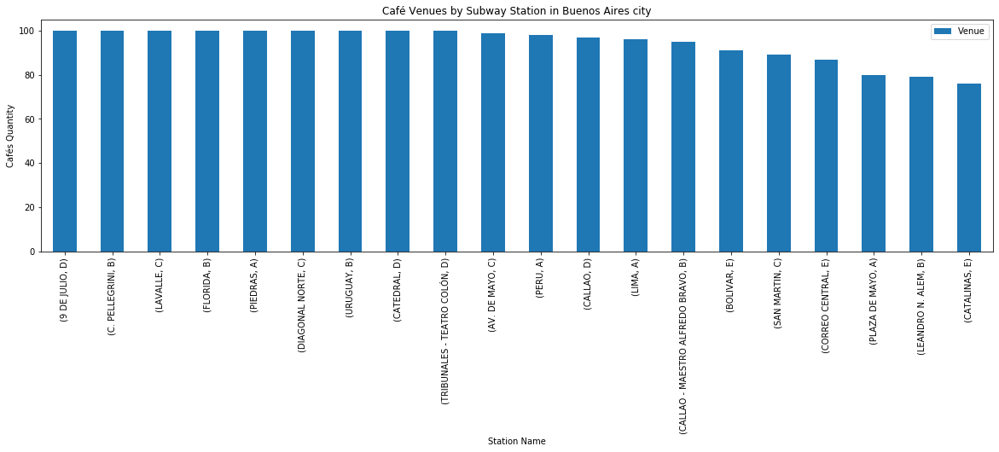

In [65]:
# Visualization of Subway stations with more Cafe Venues
bsas_cafes_qty.head(20).plot(kind='bar', figsize=(20, 5))
plt.xlabel('Station Name') # add to x-label to the plot
plt.ylabel('Cafés Quantity') # add y-label to the plot
plt.title('Café Venues by Subway Station in Buenos Aires city') # add title to the plot
plt.show()

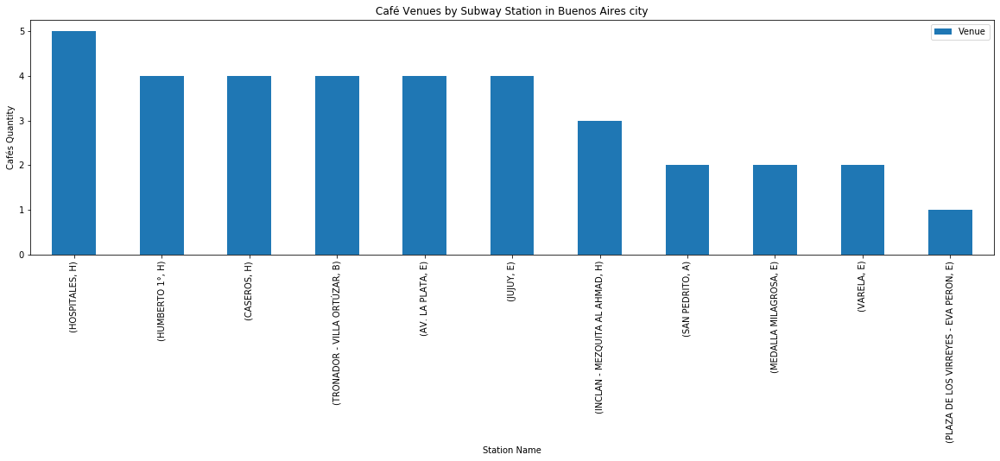

In [66]:
# Visualization of Subway stations with LESS Cafe Venues
bsas_cafes_min=bsas_cafes_qty[bsas_cafes_qty['Venue'] < 6]
bsas_cafes_min.plot(kind='bar', figsize=(20,5))
plt.xlabel('Station Name') # add to x-label to the plot
plt.ylabel('Cafés Quantity') # add y-label to the plot
plt.title('Café Venues by Subway Station in Buenos Aires city') # add title to the plot
plt.show()

The previous visualization shows the Stations with less Coffee shops in their nearby.

Lets group it with data set sun containing subway stations information

In [67]:
sub.head()

,long,lat,Station Name,Station Line,Borough,total,totalN
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO,361379,0.173803
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA,280248,0.134783
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA,119855,0.057643
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO,426167,0.204962


In [68]:
bsas_cafes_qty=bsas_cafes_qty.rename(columns={'Venue':'Cafes'})
bsas_cafes_qty.tail()

,,Cafes
Station Name,Station Line,
INCLAN - MEZQUITA AL AHMAD,H,3
SAN PEDRITO,A,2
MEDALLA MILAGROSA,E,2
VARELA,E,2
PLAZA DE LOS VIRREYES - EVA PERON,E,1


In [69]:
#Join qty of cafes per station to sub dataset
sub=pd.merge(sub,bsas_cafes_qty,how='left',on=['Station Name','Station Line'],sort=True)
print(sub.shape)
sub.head()                                            

(90, 8)


,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158,100
1,-58.436429,-34.618280,ACOYTE,A,CABALLITO,361379,0.173803,29
2,-58.407161,-34.591628,AGÜERO,D,RECOLETA,280248,0.134783,58
3,-58.401208,-34.609834,ALBERTI,A,BALVANERA,119855,0.057643,23
4,-58.420962,-34.603165,ALMAGRO - MEDRANO,B,ALMAGRO,426167,0.204962,27


In [70]:
sub=sub.sort_values(by=['Cafes'], ascending=False).reset_index(drop=True)
sub.head(15)

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158,100
1,-58.380715,-34.603637,C. PELLEGRINI,B,SAN NICOLAS,550765,0.264886,100
2,-58.378156,-34.601770,LAVALLE,C,SAN NICOLAS,238121,0.114523,100
3,-58.375072,-34.603297,FLORIDA,B,SAN NICOLAS,500586,0.240753,100
4,-58.379085,-34.608882,PIEDRAS,A,MONSERRAT,189822,0.091293,100
5,-58.379530,-34.604844,DIAGONAL NORTE,C,SAN NICOLAS,128749,0.061921,100
6,-58.387296,-34.604094,URUGUAY,B,SAN NICOLAS,387976,0.186594,100
7,-58.373956,-34.607802,CATEDRAL,D,SAN NICOLAS,754907,0.363067,100
8,-58.385142,-34.601587,TRIBUNALES - TEATRO COLÓN,D,SAN NICOLAS,372024,0.178922,100
9,-58.380611,-34.608983,AV. DE MAYO,C,MONSERRAT,138105,0.066421,99


Normalizing qty of Cafes column using simple feature Scaling

In [71]:
sub['CafesN']=sub['Cafes']/sub['Cafes'].max() 
sub.head()

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes,CafesN
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158,100,1.0
1,-58.380715,-34.603637,C. PELLEGRINI,B,SAN NICOLAS,550765,0.264886,100,1.0
2,-58.378156,-34.601770,LAVALLE,C,SAN NICOLAS,238121,0.114523,100,1.0
3,-58.375072,-34.603297,FLORIDA,B,SAN NICOLAS,500586,0.240753,100,1.0
4,-58.379085,-34.608882,PIEDRAS,A,MONSERRAT,189822,0.091293,100,1.0


Joining sub dataset with Borough information

In [72]:
borough.head()

,WKT,Borough,comuna,perimetro,area,Population
0,"POLYGON ((-58.4771156675186 -34.5951149914833,...",AGRONOMIA,15,6556.167772,2.122169e+06,13912
1,"POLYGON ((-58.4128700313089 -34.6141162515854,...",ALMAGRO,5,8537.901368,4.050752e+06,131699
2,"POLYGON ((-58.4119188098038 -34.5980030767748,...",BALVANERA,3,8375.821811,4.342280e+06,138926
3,"POLYGON ((-58.3703353711449 -34.6329258371189,...",BARRACAS,4,12789.791771,7.953453e+06,89452
4,"POLYGON ((-58.4505669109009 -34.5356104340406,...",BELGRANO,13,20609.775397,7.999240e+06,126267


In [73]:
sub=sub.join(borough.set_index('Borough'), on='Borough')
sub=sub.drop(['perimetro','WKT','comuna'],axis=1)
sub['CafesN']=sub['Cafes']/sub['Cafes'].max() 
sub['tot/cafes']=sub['total']/sub['Cafes']
sub['Pop/cafes']=sub['Population']/sub['Cafes']
sub['Pop/area']=sub['Population']/sub['area']
sub.head()

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes,CafesN,area,Population,tot/cafes,Pop/cafes,Pop/area
0,-58.380574,-34.604245,9 DE JULIO,D,SAN NICOLAS,229045,0.110158,100,1.0,2.289008e+06,29273,2290.45,292.73,0.012789
1,-58.380715,-34.603637,C. PELLEGRINI,B,SAN NICOLAS,550765,0.264886,100,1.0,2.289008e+06,29273,5507.65,292.73,0.012789
2,-58.378156,-34.601770,LAVALLE,C,SAN NICOLAS,238121,0.114523,100,1.0,2.289008e+06,29273,2381.21,292.73,0.012789
3,-58.375072,-34.603297,FLORIDA,B,SAN NICOLAS,500586,0.240753,100,1.0,2.289008e+06,29273,5005.86,292.73,0.012789
4,-58.379085,-34.608882,PIEDRAS,A,MONSERRAT,189822,0.091293,100,1.0,2.198622e+06,39914,1898.22,399.14,0.018154


### Correlation study
After adding all possible predictors to the sub dataframe we evaluate which has a stronger relation to estimate Cafes placement
The group of Stations with less Coffee Shops demonstrated positive correlation with population of neighborhood

In [74]:
s=sub[sub['Cafes']<40]
s= s[['Cafes', 'total', 'area','Population','tot/cafes','Pop/cafes','Pop/area']]
s.corr()

,Cafes,total,area,Population,tot/cafes,Pop/cafes,Pop/area
Cafes,1.000000,0.012397,0.265167,0.431900,-0.411170,-0.405184,0.412346
total,0.012397,1.000000,0.087382,0.024022,0.695838,-0.030861,-0.090469
area,0.265167,0.087382,1.000000,0.825216,0.049459,0.279852,-0.157403
Population,0.431900,0.024022,0.825216,1.000000,-0.041607,0.262980,0.391329
tot/cafes,-0.411170,0.695838,0.049459,-0.041607,1.000000,0.518370,-0.207187
Pop/cafes,-0.405184,-0.030861,0.279852,0.262980,0.518370,1.000000,-0.083227
Pop/area,0.412346,-0.090469,-0.157403,0.391329,-0.207187,-0.083227,1.000000


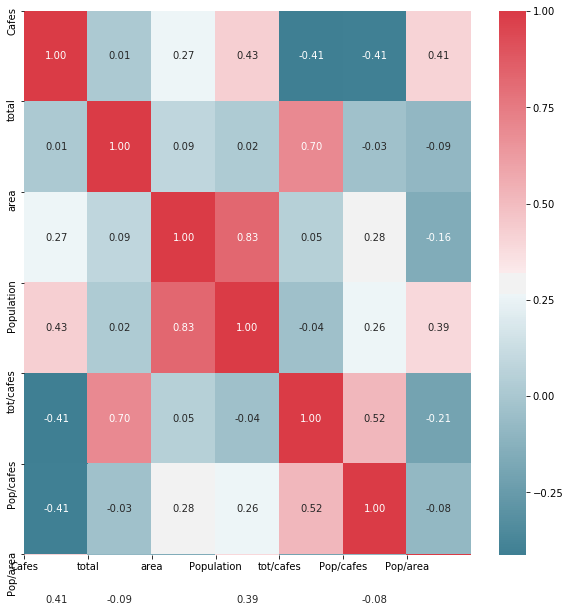

In [75]:
#Create Correlation df
corr = s.corr()
#Plot figsize
fig, ax = plt.subplots(figsize=(10, 10))
#Generate Color Map
colormap = sns.diverging_palette(220, 10, as_cmap=True)
#Generate Heat Map, allow annotations and place floats in map
sns.heatmap(corr, cmap=colormap, annot=True, fmt=".2f")
#Apply xticks
plt.xticks(range(len(corr.columns)), corr.columns);
#Apply yticks
plt.yticks(range(len(corr.columns)), corr.columns)
#show plot
plt.show()

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(0, 105.01753755825362)

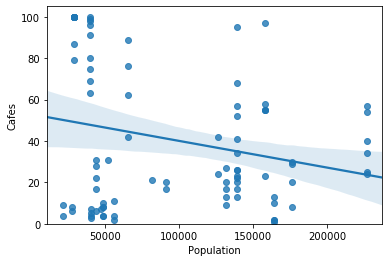

In [76]:
sns.regplot(x='Population',y='Cafes', data=sub)
plt.ylim(0,)

In [77]:
bsas_cafes_min=sub[sub['Cafes']<6]
bsas_cafes_min.sort_values('Cafes',ascending=True)

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes,CafesN,area,Population,tot/cafes,Pop/cafes,Pop/area
89,-58.461652,-34.643312,PLAZA DE LOS VIRREYES - EVA PERON,E,FLORES,204761,0.098478,1,0.01,8.590784e+06,164310,204761.000000,164310.000000,0.019126
86,-58.469640,-34.630707,SAN PEDRITO,A,FLORES,709365,0.341164,2,0.02,8.590784e+06,164310,354682.500000,82155.000000,0.019126
87,-58.450278,-34.636389,MEDALLA MILAGROSA,E,PARQUE CHACABUCO,46293,0.022264,2,0.02,3.832117e+06,56281,23146.500000,28140.500000,0.014687
88,-58.457892,-34.640137,VARELA,E,FLORES,54189,0.026062,2,0.02,8.590784e+06,164310,27094.500000,82155.000000,0.019126
85,-58.400970,-34.629376,INCLAN - MEZQUITA AL AHMAD,H,PARQUE PATRICIOS,139835,0.067253,3,0.03,3.743440e+06,40985,46611.666667,13661.666667,0.010948
80,-58.402323,-34.623092,HUMBERTO 1°,H,SAN CRISTOBAL,156245,0.075145,4,0.04,2.043711e+06,48611,39061.250000,12152.750000,0.023786
81,-58.398928,-34.635750,CASEROS,H,PARQUE PATRICIOS,173424,0.083407,4,0.04,3.743440e+06,40985,43356.000000,10246.250000,0.010948
82,-58.466227,-34.584095,TRONADOR - VILLA ORTÚZAR,B,VILLA ORTUZAR,143220,0.068881,4,0.04,1.853802e+06,21736,35805.000000,5434.000000,0.011725
83,-58.426789,-34.627015,AV. LA PLATA,E,PARQUE CHACABUCO,123089,0.059199,4,0.04,3.832117e+06,56281,30772.250000,14070.250000,0.014687
84,-58.402937,-34.623866,JUJUY,E,SAN CRISTOBAL,79044,0.038016,4,0.04,2.043711e+06,48611,19761.000000,12152.750000,0.023786


No correlation found between the features selected to predict a model

In [78]:
bsas_cafes_min.sort_values('Cafes',ascending=True)

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes,CafesN,area,Population,tot/cafes,Pop/cafes,Pop/area
89,-58.461652,-34.643312,PLAZA DE LOS VIRREYES - EVA PERON,E,FLORES,204761,0.098478,1,0.01,8.590784e+06,164310,204761.000000,164310.000000,0.019126
86,-58.469640,-34.630707,SAN PEDRITO,A,FLORES,709365,0.341164,2,0.02,8.590784e+06,164310,354682.500000,82155.000000,0.019126
87,-58.450278,-34.636389,MEDALLA MILAGROSA,E,PARQUE CHACABUCO,46293,0.022264,2,0.02,3.832117e+06,56281,23146.500000,28140.500000,0.014687
88,-58.457892,-34.640137,VARELA,E,FLORES,54189,0.026062,2,0.02,8.590784e+06,164310,27094.500000,82155.000000,0.019126
85,-58.400970,-34.629376,INCLAN - MEZQUITA AL AHMAD,H,PARQUE PATRICIOS,139835,0.067253,3,0.03,3.743440e+06,40985,46611.666667,13661.666667,0.010948
80,-58.402323,-34.623092,HUMBERTO 1°,H,SAN CRISTOBAL,156245,0.075145,4,0.04,2.043711e+06,48611,39061.250000,12152.750000,0.023786
81,-58.398928,-34.635750,CASEROS,H,PARQUE PATRICIOS,173424,0.083407,4,0.04,3.743440e+06,40985,43356.000000,10246.250000,0.010948
82,-58.466227,-34.584095,TRONADOR - VILLA ORTÚZAR,B,VILLA ORTUZAR,143220,0.068881,4,0.04,1.853802e+06,21736,35805.000000,5434.000000,0.011725
83,-58.426789,-34.627015,AV. LA PLATA,E,PARQUE CHACABUCO,123089,0.059199,4,0.04,3.832117e+06,56281,30772.250000,14070.250000,0.014687
84,-58.402937,-34.623866,JUJUY,E,SAN CRISTOBAL,79044,0.038016,4,0.04,2.043711e+06,48611,19761.000000,12152.750000,0.023786


In [79]:
bsas_cafes_min.sort_values('Population',ascending=False)

,long,lat,Station Name,Station Line,Borough,total,totalN,Cafes,CafesN,area,Population,tot/cafes,Pop/cafes,Pop/area
86,-58.469640,-34.630707,SAN PEDRITO,A,FLORES,709365,0.341164,2,0.02,8.590784e+06,164310,354682.500000,82155.000000,0.019126
88,-58.457892,-34.640137,VARELA,E,FLORES,54189,0.026062,2,0.02,8.590784e+06,164310,27094.500000,82155.000000,0.019126
89,-58.461652,-34.643312,PLAZA DE LOS VIRREYES - EVA PERON,E,FLORES,204761,0.098478,1,0.01,8.590784e+06,164310,204761.000000,164310.000000,0.019126
83,-58.426789,-34.627015,AV. LA PLATA,E,PARQUE CHACABUCO,123089,0.059199,4,0.04,3.832117e+06,56281,30772.250000,14070.250000,0.014687
87,-58.450278,-34.636389,MEDALLA MILAGROSA,E,PARQUE CHACABUCO,46293,0.022264,2,0.02,3.832117e+06,56281,23146.500000,28140.500000,0.014687
80,-58.402323,-34.623092,HUMBERTO 1°,H,SAN CRISTOBAL,156245,0.075145,4,0.04,2.043711e+06,48611,39061.250000,12152.750000,0.023786
84,-58.402937,-34.623866,JUJUY,E,SAN CRISTOBAL,79044,0.038016,4,0.04,2.043711e+06,48611,19761.000000,12152.750000,0.023786
79,-58.412385,-34.641269,HOSPITALES,H,PARQUE PATRICIOS,339081,0.163079,5,0.05,3.743440e+06,40985,67816.200000,8197.000000,0.010948
81,-58.398928,-34.635750,CASEROS,H,PARQUE PATRICIOS,173424,0.083407,4,0.04,3.743440e+06,40985,43356.000000,10246.250000,0.010948
85,-58.400970,-34.629376,INCLAN - MEZQUITA AL AHMAD,H,PARQUE PATRICIOS,139835,0.067253,3,0.03,3.743440e+06,40985,46611.666667,13661.666667,0.010948


In [80]:
# MAP Buenos Aires
map_bsas=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)
map_bsas.choropleth(
    geo_data=bsas_geo,
    columns=['Borough','Population'],
    key_on='feature.properties.barrio',
    fill_color='YlOrRd', 
    fill_opacity=0.05, 
    line_opacity=0,
    legend_name='Population in Buenos Aires city'
)
#add Stations to the Map
markers_colors = []
for lat, lon, station, line in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=2,
        popup=label,
        color='black',
        fill=True,
        fill_opacity=0.7).add_to(map_bsas) 
map_bsas

In [81]:
#Add Caffes
markers_colors = []
for lat, lon, venue in zip(bsas_cafes['Venue Latitude'], bsas_cafes['Venue Longitude'], bsas_cafes['Venue']):
    label = folium.Popup(str(venue), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=2,
        popup=label,
        color='blue',
        fill=True,
        fill_opacity=0.5).add_to(map_bsas)
map_bsas

In [82]:
#Heatmap showing Coffe Shops found nearby stations
# MAP Buenos Aires
map_bsas=folium.Map(location=[-34.6075616, -58.437076], zoom_start=12, min_zoom=11, max_zoom=16,control_scale=True)
map_bsas.choropleth(
    geo_data=bsas_geo,
    columns=['Borough','Population'],
    key_on='feature.properties.barrio',
    fill_color='YlOrRd', 
    fill_opacity=0.05, 
    line_opacity=0,
    legend_name='Population in Buenos Aires city'
)
#add Stations to the Map
markers_colors = []
for lat, lon, station, line in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=2,
        popup=label,
        color='black',
        fill=True,
        fill_opacity=0.7).add_to(map_bsas) 

heat_cafe = bsas_cafes[['Venue Latitude', 'Venue Longitude']]

# List comprehension to make out list of lists
heat_data = [[row['Venue Latitude'],row['Venue Longitude']] for index, row in heat_cafe.iterrows()]

#add Stations to the Map
markers_colors = []
for lat, lon, station, line in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=2,
        popup=label,
        color='black',
        fill=False,
        fill_opacity=0.3).add_to(map_bsas) 

# Plot it on the map
HeatMap(heat_data, min_opacity=0.3, radius=25, blur=15).add_to(map_bsas)
map_bsas

In [ ]:
#Add Stations with less Venues
for lat, lon, station, line in zip(bsas_cafes_min['lat'], bsas_cafes_min['long'], bsas_cafes_min['Station Name'], bsas_cafes_min['Station Line']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.Marker(
        [lat, lon],
        popup=label).add_to(map_bsas) 
map_bsas


In [ ]:
for lat, lon, station, line,totalN in zip(sub['lat'], sub['long'], sub['Station Name'], sub['Station Line'],sub['totalN']):
    label = folium.Popup(str(station) + ' (line ' + str(line) + ')', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=totalN*40,
        popup=label,
        color='green',
        fill=True,
        fill_opacity=0.3).add_to(map_bsas) 
map_bsas